In [ ]:
!pip install torch torchvision pydicom pillow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 20.3 MB/s eta 0:00:00


In [ ]:
# 구글 드라이브 마운트
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sat Nov 30 05:18:57 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0              49W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 19.6 MB/s eta 0:00:00


In [ ]:
print(f"Using device: {device}")

Using device: cuda


In [ ]:
import os
import torch
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision.transforms import ToTensor, Normalize, Resize

# 데이터셋 클래스 정의
class DicomDataset(Dataset):
    def __init__(self, pre_folder, post_folder, transform=None, img_size=(256, 256)): # Add img_size parameter
        """
        Args:
            pre_folder (str): 수술 전 이미지 폴더
            post_folder (str): 수술 후 이미지 폴더
            transform (callable, optional): 이미지 변환 함수
            img_size (tuple): Desired output image size (height, width)
        """
        self.pre_files = sorted(os.listdir(pre_folder))
        self.post_files = sorted(os.listdir(post_folder))
        self.pre_folder = pre_folder
        self.post_folder = post_folder
        self.transform = transform
        self.resize = Resize(img_size) # Initialize Resize transform

    def __len__(self):
        return min(len(self.pre_files), len(self.post_files))

    def __getitem__(self, idx):
        pre_path = os.path.join(self.pre_folder, self.pre_files[idx])
        post_path = os.path.join(self.post_folder, self.post_files[idx])

        # DICOM 파일 읽기
        pre_dcm = pydicom.dcmread(pre_path).pixel_array
        post_dcm = pydicom.dcmread(post_path).pixel_array

        # 정규화 (-1~1 범위로 스케일링)
        pre_image = (torch.tensor(pre_dcm / 255.0, dtype=torch.float32) * 2) - 1
        post_image = (torch.tensor(post_dcm / 255.0, dtype=torch.float32) * 2) - 1

        # Resize images
        pre_image = self.resize(pre_image)
        post_image = self.resize(post_image)

        if self.transform:
            pre_image = self.transform(pre_image)
            post_image = self.transform(post_image)

        return pre_image, post_image

# 데이터 경로 설정
train_pre_path = "/content/drive/MyDrive/tumorpred/data/train/pre"
train_post_path = "/content/drive/MyDrive/tumorpred/data/train/post"
val_pre_path = "/content/drive/MyDrive/tumorpred/data/val/pre"
val_post_path = "/content/drive/MyDrive/tumorpred/data/val/post"

# 데이터 로더 정의 (이미 정의된 DicomDataset 사용)
train_dataset = DicomDataset(train_pre_path, train_post_path, img_size=(256, 256))
val_dataset = DicomDataset(val_pre_path, val_post_path, img_size=(256, 256))
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

print(f"Train dataset size: {len(train_dataset)}")
print(f"Validation dataset size: {len(val_dataset)}")

Train dataset size: 480
Validation dataset size: 120


In [ ]:
import torch.nn as nn

# Generator: U-Net 구조
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        # U-Net 구성 요소 추가 (간단한 버전)
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=4, stride=2, padding=1),
            nn.ReLU(True)
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Discriminator: PatchGAN 구조
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(2, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(128, 1, kernel_size=4, stride=1, padding=1),
            nn.Sigmoid()
        )

    def forward(self, pre, post):
        x = torch.cat([pre, post], dim=1)  # Combine pre and post images along channel axis
        return self.model(x)

In [ ]:
# 디바이스 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# 모델 초기화
generator = Generator().to(device)
discriminator = Discriminator().to(device)

# 손실 함수 정의
criterion_gan = nn.BCELoss()  # GAN Loss
criterion_l1 = nn.L1Loss()    # L1 Loss

# 옵티마이저 정의
optimizer_gen = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_disc = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Discriminator 출력 크기 계산
test_input_pre = torch.randn(1, 1, 256, 256).to(device)  # [batch_size, channels, height, width]
test_input_post = torch.randn(1, 1, 256, 256).to(device)
test_output = discriminator(test_input_pre, test_input_post)
discriminator_output_height = test_output.shape[2]
discriminator_output_width = test_output.shape[3]

print(f"Discriminator Output Size: {discriminator_output_height} x {discriminator_output_width}")

print(generator)
print(discriminator)

Using device: cuda
Discriminator Output Size: 63 x 63
Generator(
  (encoder): Sequential(
    (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): ReLU(inplace=True)
  )
  (decoder): Sequential(
    (0): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): Sigmoid()
  )
)
Discriminator(
  (model): Sequential(
    (0): Conv2d(2, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Conv2d(128, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    (5): Sigmoid()
  )
)


In [ ]:
for pre, post in train_loader:
    print(f"Pre shape: {pre.shape}, Post shape: {post.shape}")
    break

Pre shape: torch.Size([4, 1, 256, 256]), Post shape: torch.Size([4, 1, 256, 256])


In [ ]:
# 학습 루프
epochs = 50
for epoch in range(epochs):
    for pre_image, post_image in train_loader:
        pre_image, post_image = pre_image.to(device), post_image.to(device)

        ### Update Discriminator ###
        fake_image = generator(pre_image)
        real_label = torch.ones(pre_image.size(0), 1, discriminator_output_height, discriminator_output_width).to(device)
        fake_label = torch.zeros(pre_image.size(0), 1, discriminator_output_height, discriminator_output_width).to(device)

        real_loss = criterion_gan(discriminator(pre_image, post_image), real_label)
        fake_loss = criterion_gan(discriminator(pre_image, fake_image.detach()), fake_label)
        disc_loss = (real_loss + fake_loss) / 2

        optimizer_disc.zero_grad()
        disc_loss.backward()
        optimizer_disc.step()

        ### Update Generator ###
        gan_loss = criterion_gan(discriminator(pre_image, fake_image), real_label)
        l1_loss = criterion_l1(fake_image, post_image)
        gen_loss = gan_loss + 100 * l1_loss

        optimizer_gen.zero_grad()
        gen_loss.backward()
        optimizer_gen.step()

    print(f"Epoch [{epoch+1}/{epochs}], Gen Loss: {gen_loss.item():.4f}, Disc Loss: {disc_loss.item():.4f}")

In [ ]:
# Validation 데이터셋 크기
val_dataset_size = len(val_loader.dataset)

# DataLoader에서 설정한 batch_size
batch_size = val_loader.batch_size

# 총 배치 수 계산
total_batches = (val_dataset_size + batch_size - 1) // batch_size  # 올림 계산
print(f"Validation dataset size: {val_dataset_size}")
print(f"Batch size: {batch_size}")
print(f"Total batches: {total_batches}")

Validation dataset size: 120
Batch size: 4
Total batches: 30


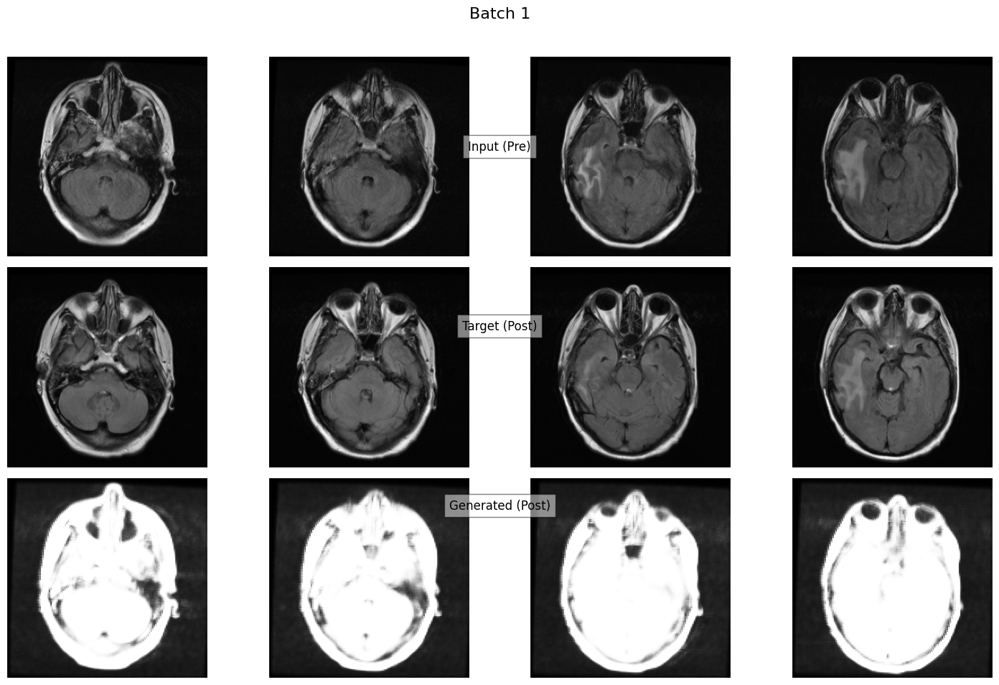

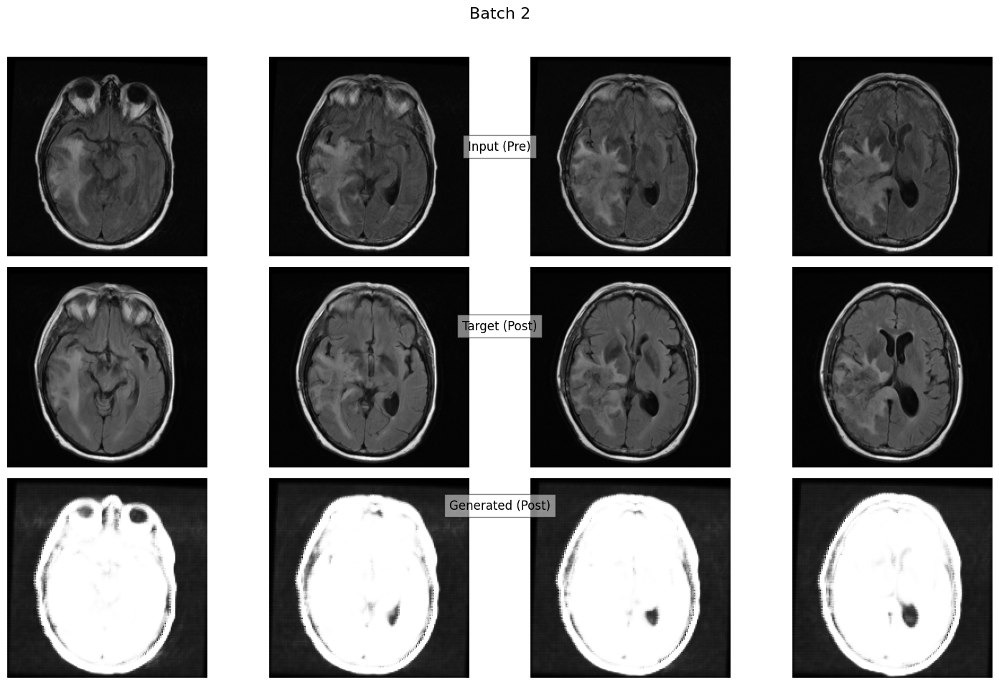

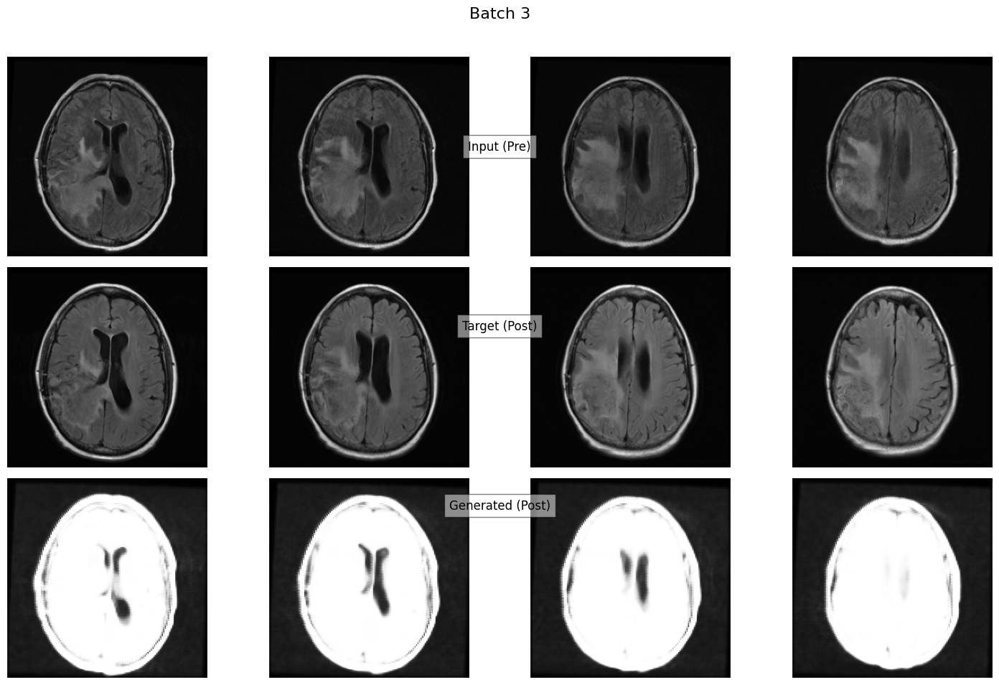

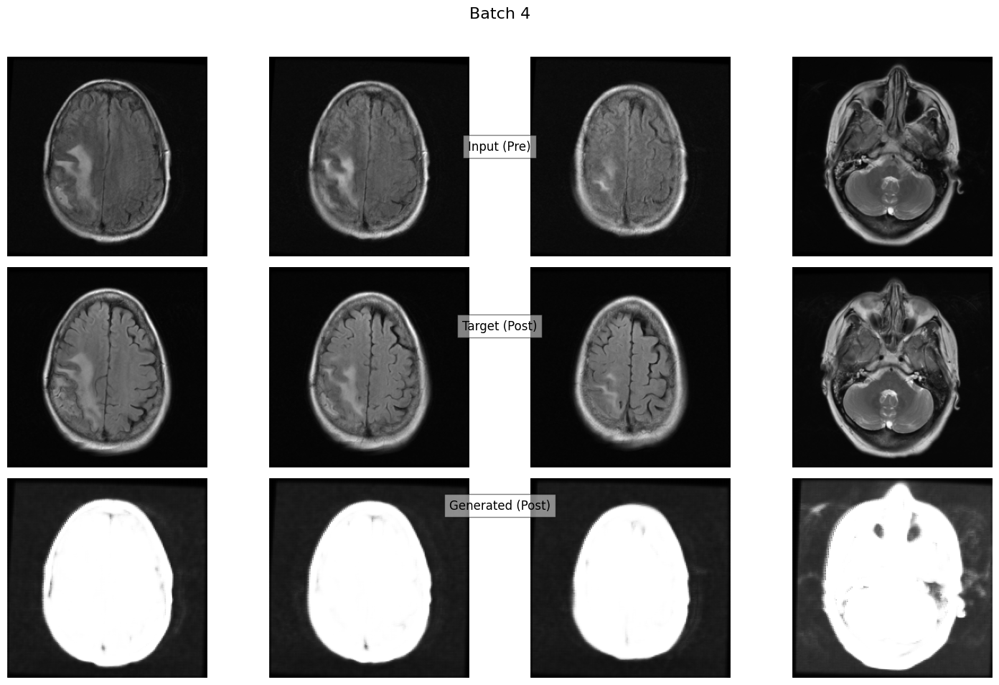

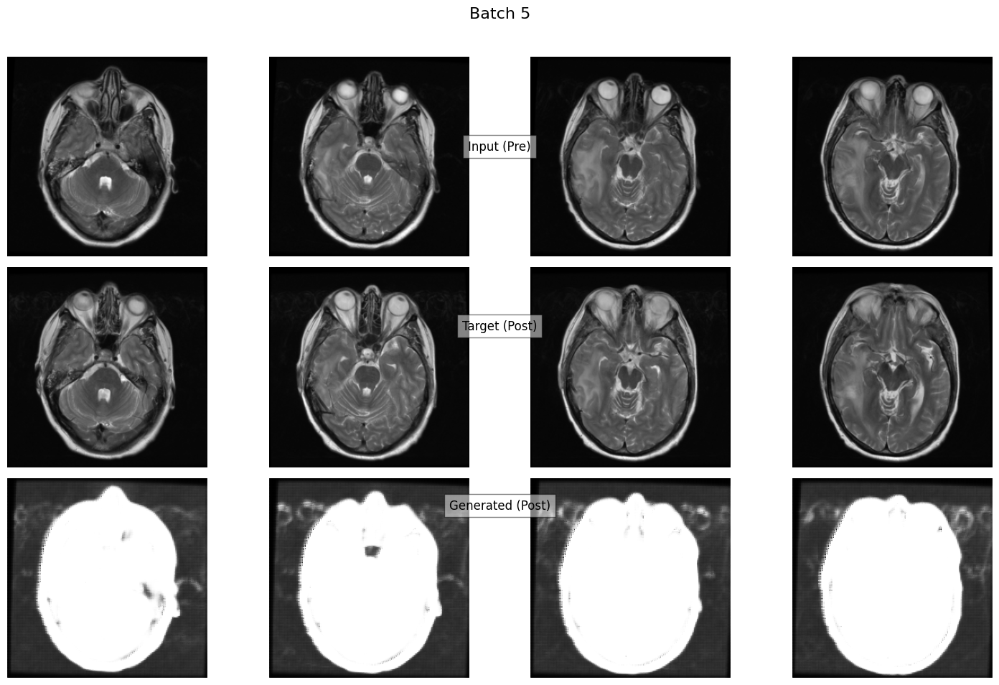

...

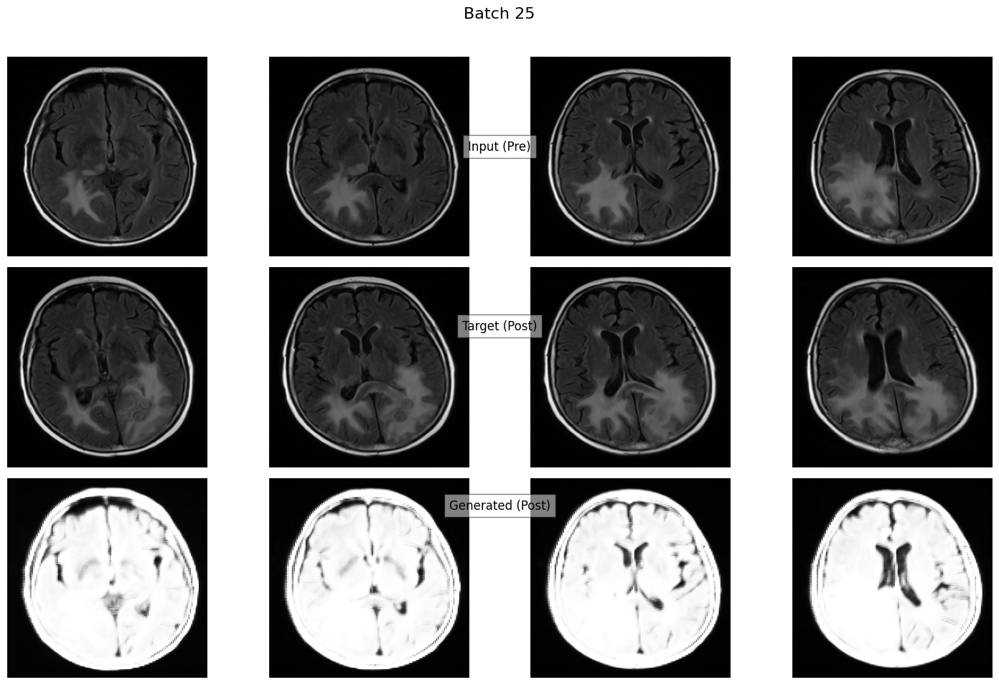

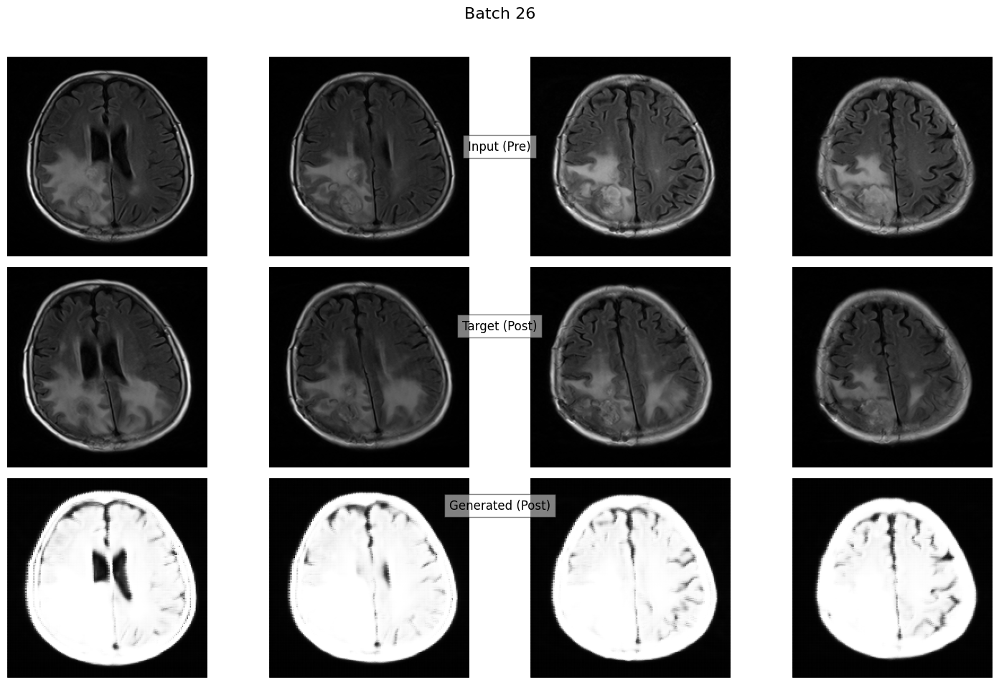

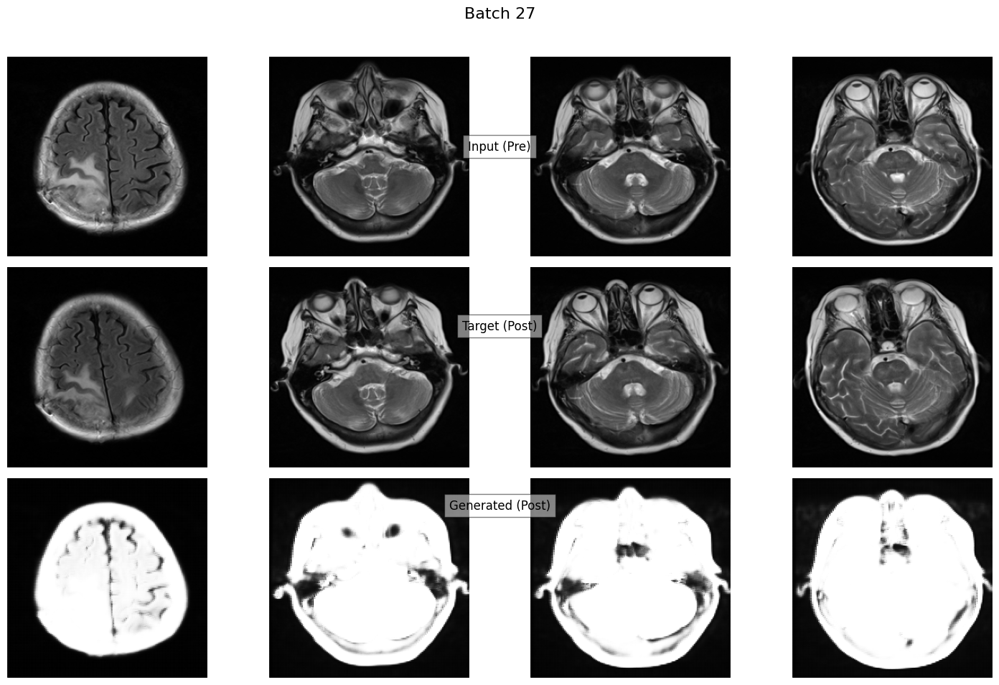

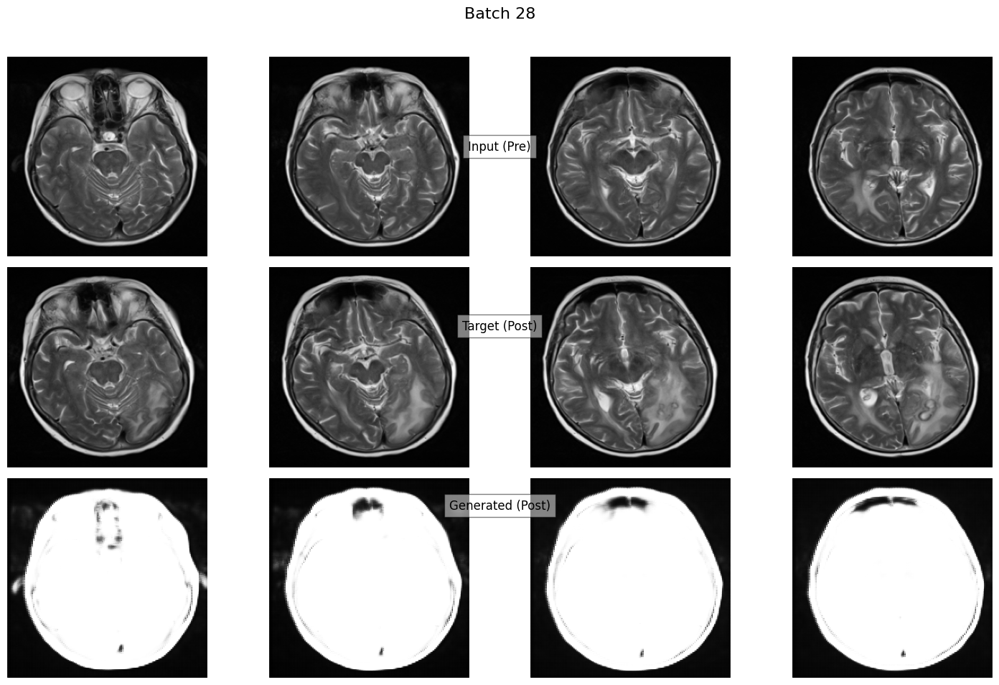

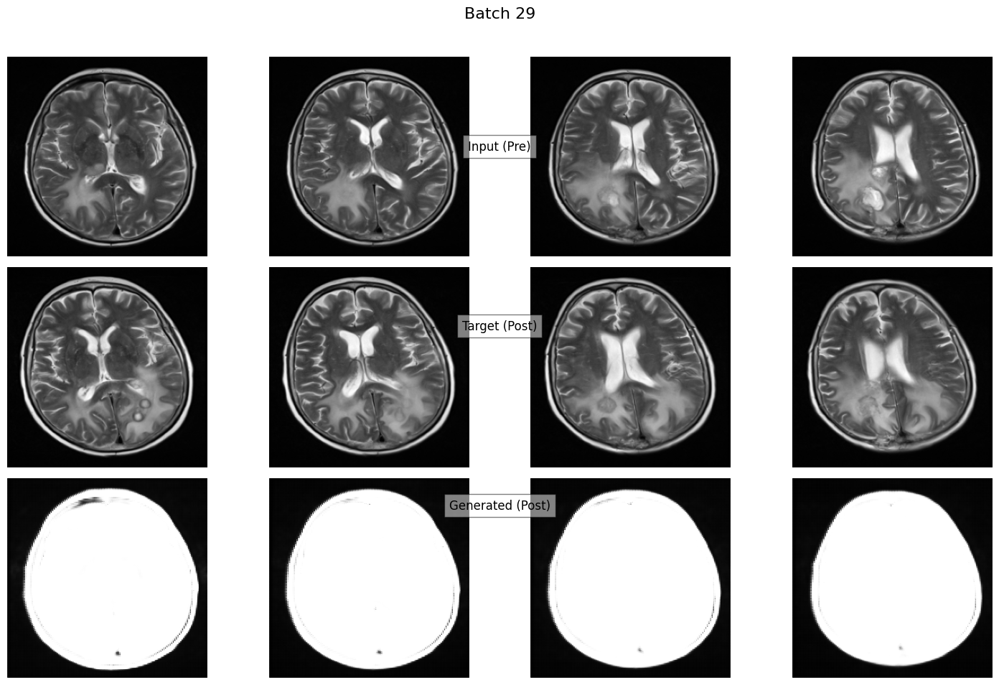

In [ ]:
import matplotlib.pyplot as plt

# # Validation 데이터에서 생성된 이미지 확인 (첫 번째와 두 번째 배치)
num_batches_to_show = 29  # 시각화할 배치 수
batch_count = 0

with torch.no_grad():
    for pre_image, post_image in val_loader:
        pre_image = pre_image.to(device)
        post_image = post_image.to(device)
        fake_image = generator(pre_image)  # 생성된 이미지

        # 배치 크기 확인
        batch_size = pre_image.size(0)

        # 배치별로 하나의 큰 그림에 묶어서 표시
        plt.figure(figsize=(15, 10))  # 배치당 전체 그림 크기 설정

        # 배치 번호 표시
        plt.suptitle(f"Batch {batch_count + 1}", fontsize=16, y=0.95)

        # Input (Pre) 행
        for i in range(batch_size):
            plt.subplot(3, batch_size, i + 1)  # 첫 번째 행
            plt.imshow(pre_image[i, 0].cpu().numpy(), cmap='gray')
            plt.axis('off')
        plt.figtext(0.5, 0.75, "Input (Pre)", ha="center", fontsize=12, bbox={"facecolor": "white", "alpha": 0.5, "pad": 5})

        # Target (Post) 행
        for i in range(batch_size):
            plt.subplot(3, batch_size, i + 1 + batch_size)  # 두 번째 행
            plt.imshow(post_image[i, 0].cpu().numpy(), cmap='gray')
            plt.axis('off')
        plt.figtext(0.5, 0.5, "Target (Post)", ha="center", fontsize=12, bbox={"facecolor": "white", "alpha": 0.5, "pad": 5})

        # Generated (Post) 행
        for i in range(batch_size):
            plt.subplot(3, batch_size, i + 1 + 2 * batch_size)  # 세 번째 행
            plt.imshow(fake_image[i, 0].cpu().numpy(), cmap='gray')
            plt.axis('off')
        plt.figtext(0.5, 0.25, "Generated (Post)", ha="center", fontsize=12, bbox={"facecolor": "white", "alpha": 0.5, "pad": 5})

        plt.tight_layout(rect=[0, 0, 1, 0.93])  # 제목과 레이아웃 간격 조정
        plt.show()

        # # 배치 카운트 증가
        batch_count += 1
        if batch_count >= num_batches_to_show:  # 설정된 배치 수까지만 표시
            break